# Annotations using clustering for cells for brain_s0

In [1]:
slide_id = "brain_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_brain_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 58584, 38957), (3, 29292, 19479)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 11) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (809076, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (809076, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (809076, 480)
      └── 'table_nuclei': AnnData (809076, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 809076 × 480
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,z_level,nucleus_count
0,aaaaaaaa-1,207,0,0,0,0,207,60.148127,42.762970,cell_labels,0.0,1.0
1,aaaaaaab-1,231,0,0,0,0,231,78.842815,52.561877,cell_labels,0.0,1.0
3,aaaaaaac-1,331,0,0,0,0,331,82.500472,34.138126,cell_labels,0.0,2.0
4,aaaaaaad-1,75,0,0,0,0,75,43.937033,25.152032,cell_labels,0.0,1.0
5,aaaaaaae-1,246,0,0,0,0,246,67.011877,44.027345,cell_labels,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
816764,aaamfigp-1,6,0,0,0,0,6,7.315313,7.315313,cell_labels,4.0,1.0
816765,aaamfiha-1,16,0,0,0,0,16,7.586250,7.586250,cell_labels,5.0,1.0
816766,aaamfihb-1,6,0,0,0,0,6,5.644531,5.644531,cell_labels,6.0,1.0
816767,aaamfihc-1,18,0,0,0,0,18,24.248907,20.681563,cell_labels,4.0,1.0


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2M,ENSG00000175899,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTB,ENSG00000075624,Gene Expression,Unknown
...,...,...,...
VSIG4,ENSG00000155659,Gene Expression,Unknown
VSIR,ENSG00000107738,Gene Expression,Unknown
VWF,ENSG00000110799,Gene Expression,Unknown
XBP1,ENSG00000100219,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 798751 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,41.002191,L5/6 excitatory neuron,169,0,2,4,2,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,50.146767,Protoplasmic astrocyte,161,0,0,0,0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,39.986850,Oligodendrocyte,203,0,0,0,0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,23.390865,Endothelial cell,41,3,4,6,4,Endothelial,Endothelial,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,42.130546,Oligodendrocyte progenitor cell,179,0,0,0,0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaamfigm-1,nucleus_boundaries,morpho,aaamfigm-1,24.157193,L2/3 excitatory neuron,25,1,1,1,1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
aaamfign-1,nucleus_boundaries,morpho,aaamfign-1,16.346013,Endothelial cell,22,3,4,6,4,Endothelial,Endothelial,normal_cell
aaamfigo-1,nucleus_boundaries,morpho,aaamfigo-1,15.624592,Endothelial cell,17,2,6,10,6,Macrophage,Macrophage,normal_cell
aaamfiha-1,nucleus_boundaries,morpho,aaamfiha-1,6.570084,Oligodendrocyte progenitor cell,14,1,1,1,1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell


In [9]:
adata_nuclei.var

,mean,std
A2M,1.603078,2.392435
ACE2,0.032940,0.389307
ACKR1,0.146301,0.816325
ACTA2,0.998720,1.960344
ACTB,5.796313,1.550985
...,...,...
VSIG4,0.429587,1.414720
VSIR,0.328281,1.225339
VWF,0.133035,0.826676
XBP1,0.967030,1.935629


## 2. Preprocessing

<Axes: >

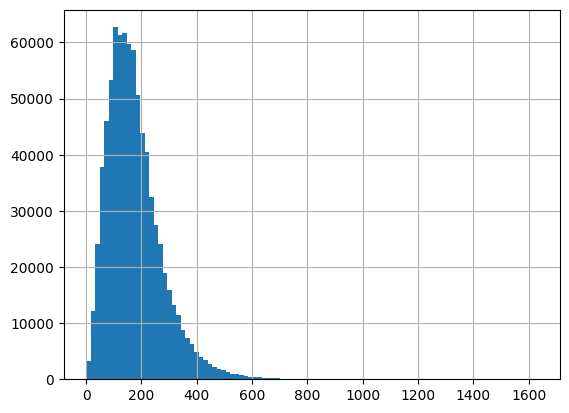

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

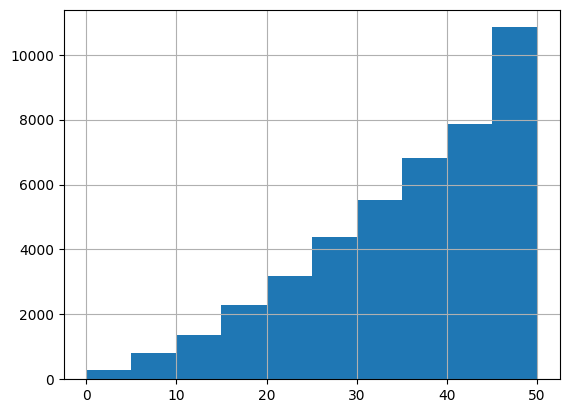

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 4743
Percentage of cells with less than 20 transcripts: 0.59%
-----
Number of cells with less than 15 transcripts: 2456
Percentage of cells with less than 15 transcripts: 0.3%
-----
Number of cells with less than 10 transcripts: 1104
Percentage of cells with less than 10 transcripts: 0.14%
-----
Number total of cells: 809076


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

807761


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


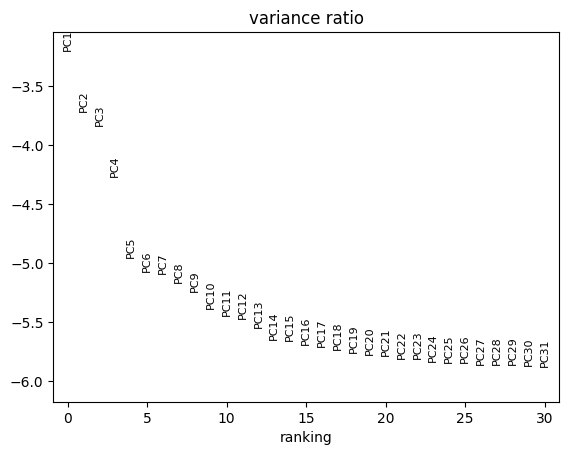

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 807761 × 480
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4337/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


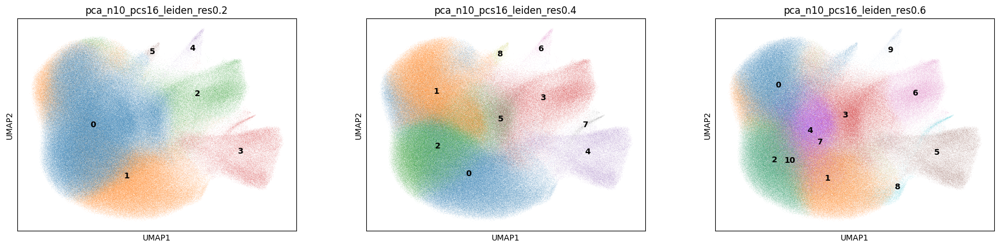

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['2', '1', '4', '0', '3', '6', '7', '5', '8']
Categories (9, object): ['0', '1', '2', '3', ..., '5', '6', '7', '8']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'

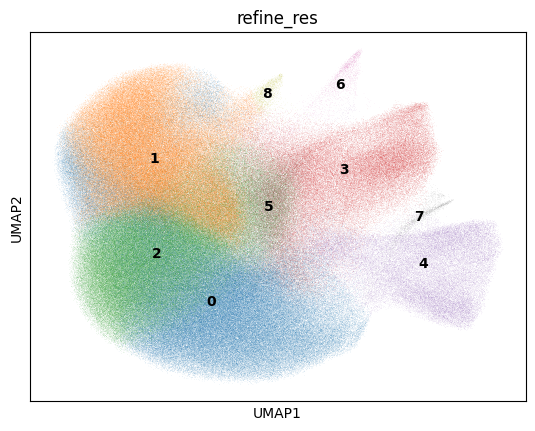

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

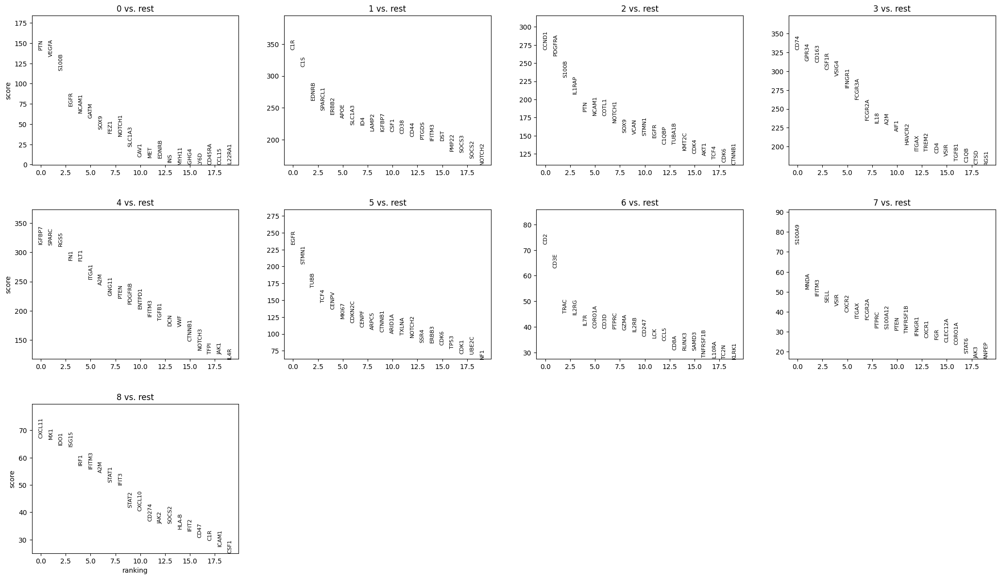

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [31]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,94.4
1,NA,NA,NA,2.8
2,Macrophage,Macrophage,normal_cell,2.7
3,Endothelial,Endothelial,normal_cell,0.1
4,T,T,normal_cell,0.0


In [33]:
top_ranked_genes[cluster_id]

0      PTN
1    VEGFA
2    S100B
3     EGFR
4    NCAM1
5     GATM
6     SOX9
Name: 0, dtype: object

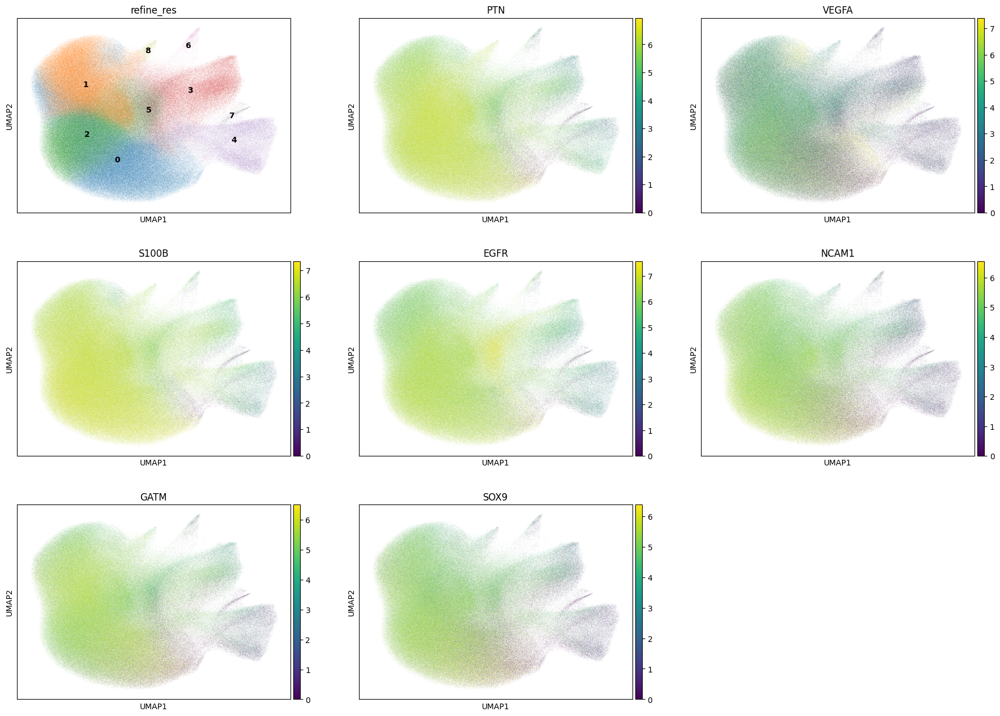

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 248643
Percentage of cells in cluster 0: 30.8


In [36]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Glioblastoma_tumor_cell_astrocyte_derived'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,98.9
1,Macrophage,Macrophage,normal_cell,0.9
2,NA,NA,NA,0.1
3,Endothelial,Endothelial,normal_cell,0.0
4,T,T,normal_cell,0.0


In [39]:
top_ranked_genes[cluster_id]

0        C1R
1        C1S
2      EDNRB
3    SPARCL1
4      ERBB2
5       APOE
6     SLC1A3
Name: 1, dtype: object

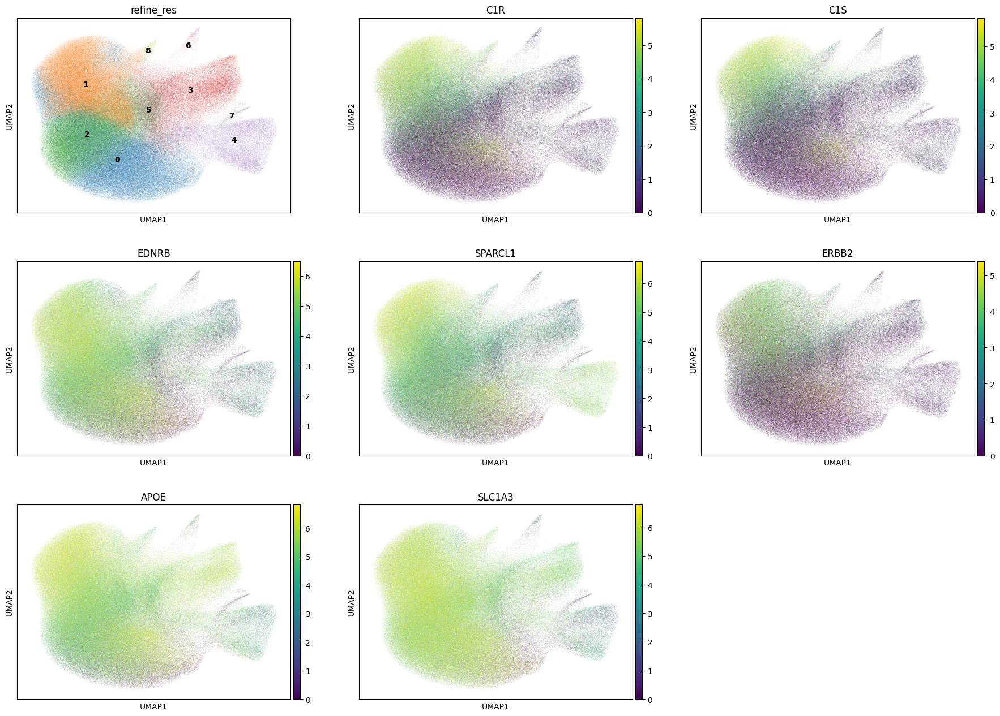

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 202214
Percentage of cells in cluster 1: 25.0


In [42]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Glioblastoma_tumor_cell_astrocyte_derived'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,91.2
1,Macrophage,Macrophage,normal_cell,8.5
2,Endothelial,Endothelial,normal_cell,0.2
3,NA,NA,NA,0.1
4,T,T,normal_cell,0.0


In [45]:
top_ranked_genes[cluster_id]

0     CCND1
1    PDGFRA
2     S100B
3    IL1RAP
4       PTN
5     NCAM1
6     COTL1
Name: 2, dtype: object

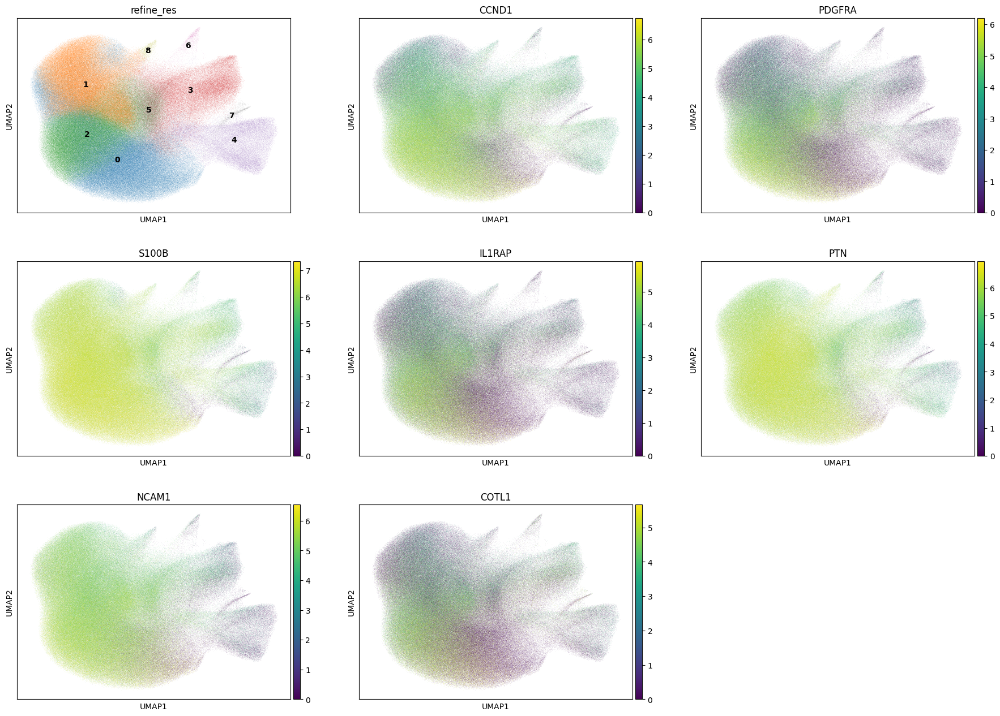

In [46]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 188864
Percentage of cells in cluster 2: 23.4


In [48]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Glioblastoma_tumor_cell_astrocyte_derived'

### 5.4. Cluster 3

In [49]:
cluster_id = '3'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage,Macrophage,normal_cell,81.4
1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,17.5
2,NA,NA,NA,0.7
3,Endothelial,Endothelial,normal_cell,0.4
4,T,T,normal_cell,0.0


In [51]:
top_ranked_genes[cluster_id]

0      CD74
1     GPR34
2     CD163
3     CSF1R
4     VSIG4
5    IFNGR1
6    FCGR3A
Name: 3, dtype: object

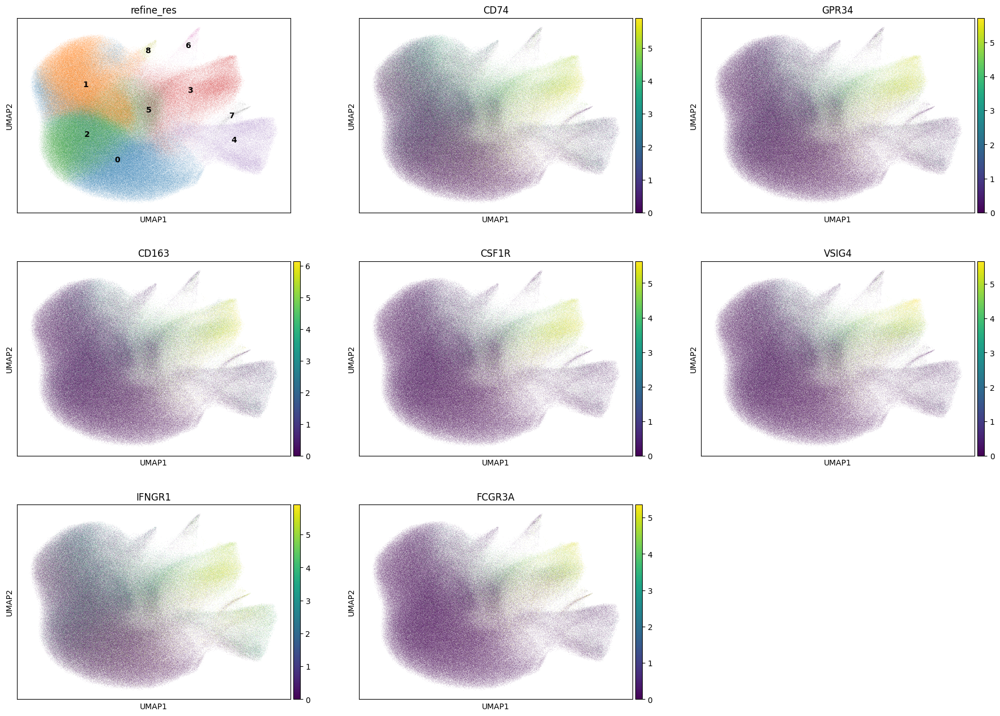

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 77694
Percentage of cells in cluster 3: 9.6


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage'

### 5.5. Cluster 4

In [55]:
cluster_id = '4'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,76.7
1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,17.9
2,Macrophage,Macrophage,normal_cell,3.4
3,NA,NA,NA,1.7
4,T,T,normal_cell,0.2


In [57]:
top_ranked_genes[cluster_id]

0    IGFBP7
1     SPARC
2      RGS5
3       FN1
4      FLT1
5     ITGA1
6       A2M
Name: 4, dtype: object

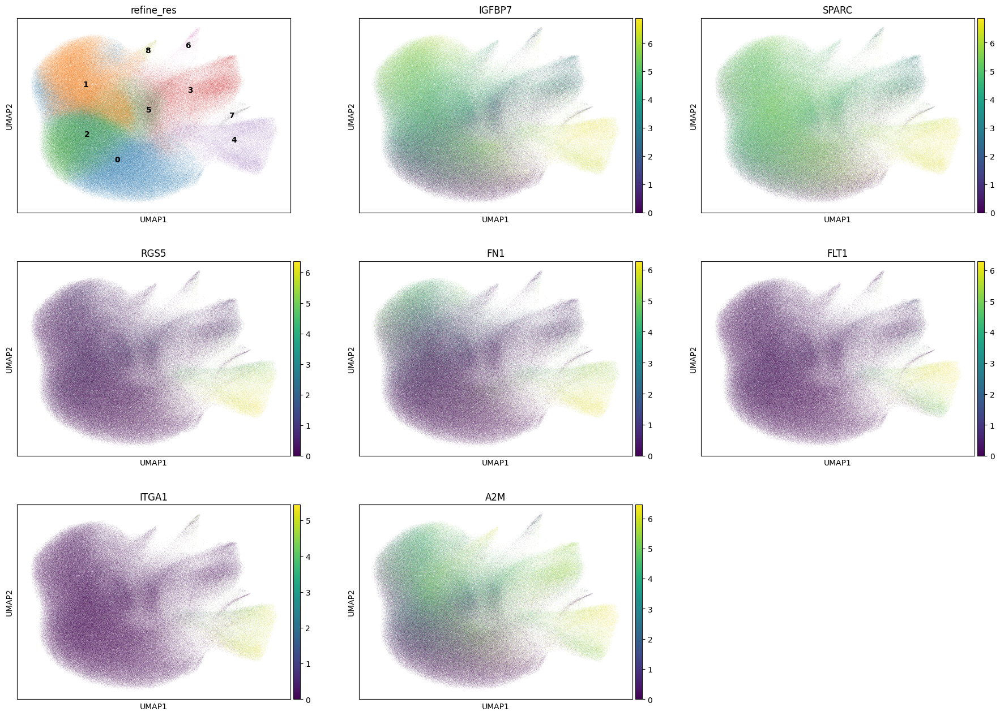

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 47392
Percentage of cells in cluster 4: 5.9


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Blood_vessel'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Blood_vessel'

### 5.6. Cluster 5

In [61]:
cluster_id = '5'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,88.3
1,Macrophage,Macrophage,normal_cell,11.1
2,NA,NA,NA,0.3
3,Endothelial,Endothelial,normal_cell,0.2
4,T,T,normal_cell,0.1


In [63]:
top_ranked_genes[cluster_id]

0      EGFR
1     STMN1
2      TUBB
3      TCF4
4     CENPV
5     MKI67
6    CDKN2C
Name: 5, dtype: object

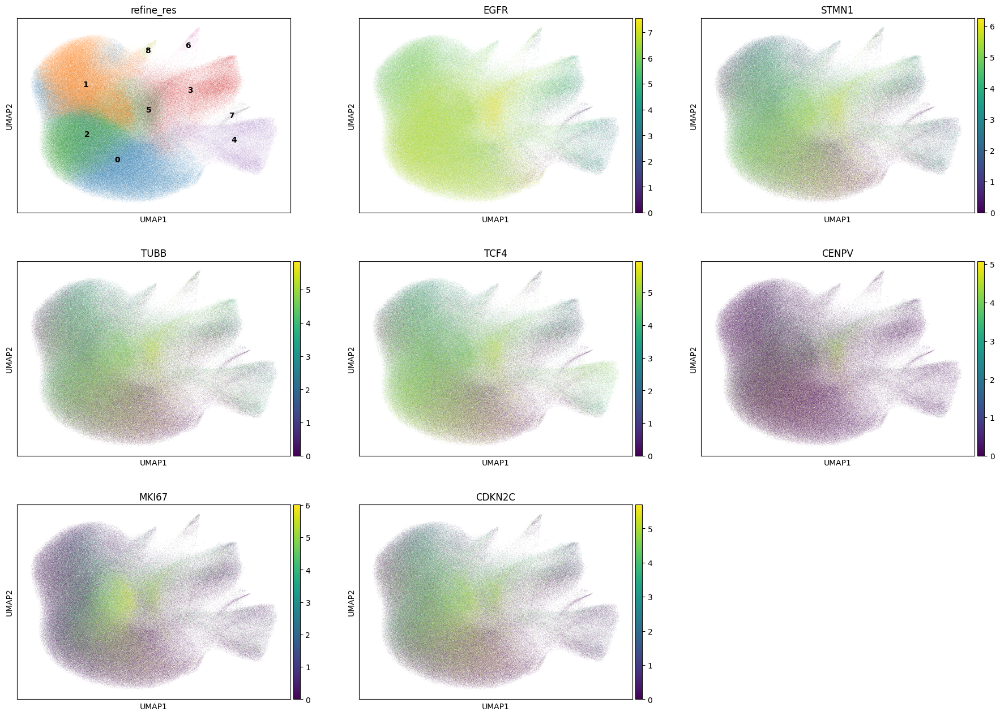

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 36340
Percentage of cells in cluster 5: 4.5


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_glioblastoma_tumor_cell_astrocyte_derived'

### 5.7. Cluster 6

In [67]:
cluster_id = '6'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,81.7
1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,14.0
2,Macrophage,Macrophage,normal_cell,2.8
3,NA,NA,NA,0.9
4,Endothelial,Endothelial,normal_cell,0.6


In [69]:
top_ranked_genes[cluster_id]

0       CD2
1      CD3E
2      TRAC
3     IL2RG
4      IL7R
5    CORO1A
6      CD3D
Name: 6, dtype: object

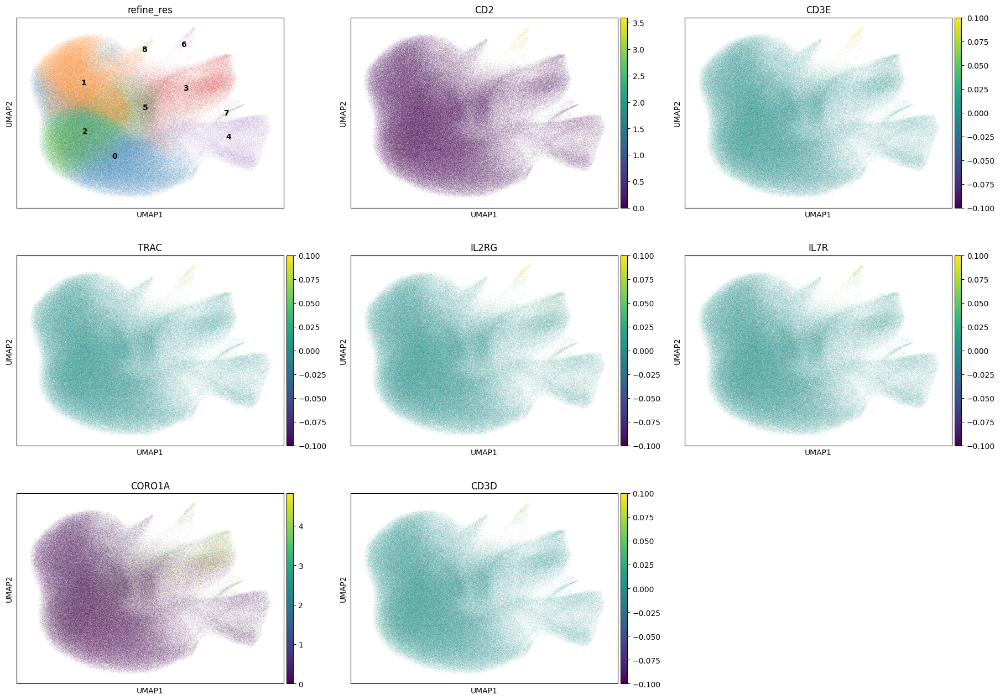

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 2741
Percentage of cells in cluster 6: 0.3


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.8. Cluster 7

In [73]:
cluster_id = '7'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage,Macrophage,normal_cell,88.1
1,NA,NA,NA,9.8
2,Endothelial,Endothelial,normal_cell,1.1
3,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,0.8
4,T,T,normal_cell,0.1


In [75]:
top_ranked_genes[cluster_id]

0    S100A9
1      MNDA
2    IFITM3
3      SELL
4      VSIR
5     CXCR2
6     ITGAX
Name: 7, dtype: object

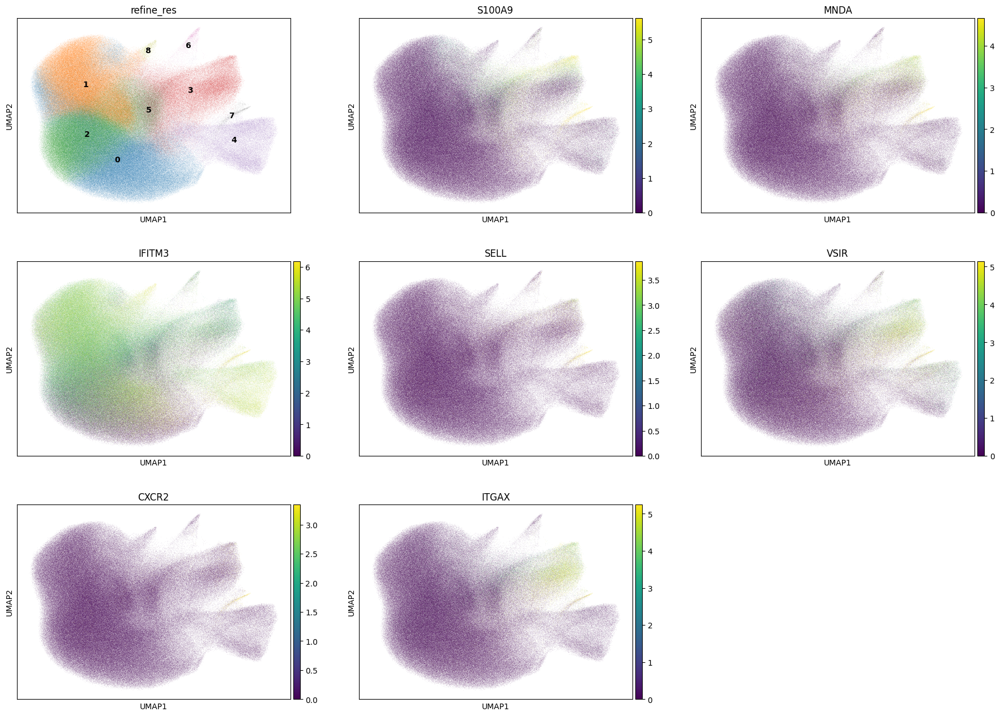

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 2162
Percentage of cells in cluster 7: 0.3


In [78]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Myeloid'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Myeloid'

### 5.9. Cluster 8

In [79]:
cluster_id = '8'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell,97.3
1,Macrophage,Macrophage,normal_cell,2.6
2,NA,NA,NA,0.1


In [81]:
top_ranked_genes[cluster_id]

0    CXCL11
1       MX1
2      IDO1
3     ISG15
4      IRF1
5    IFITM3
6       A2M
Name: 8, dtype: object

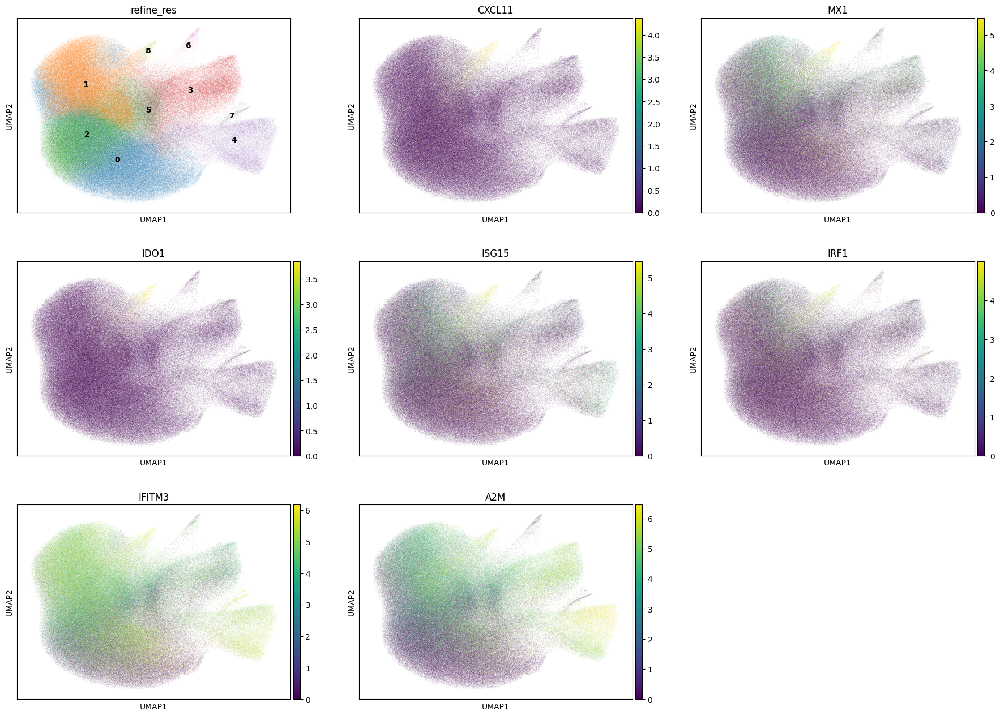

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 1711
Percentage of cells in cluster 8: 0.2


In [84]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Glioblastoma_tumor_cell_astrocyte_derived'

## 6. Cancer cells

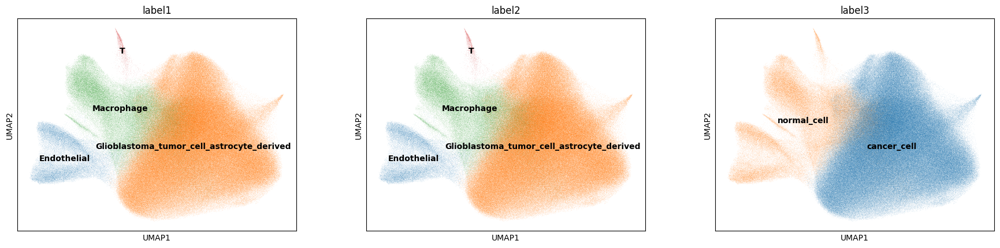

In [87]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

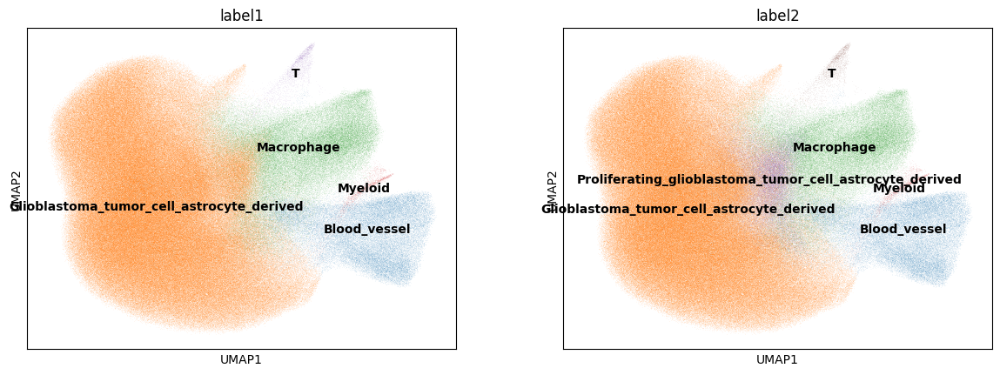

In [88]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [89]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'] == 'Glioblastoma_tumor_cell_astrocyte_derived', 'label3'] = 'cancer_cell'

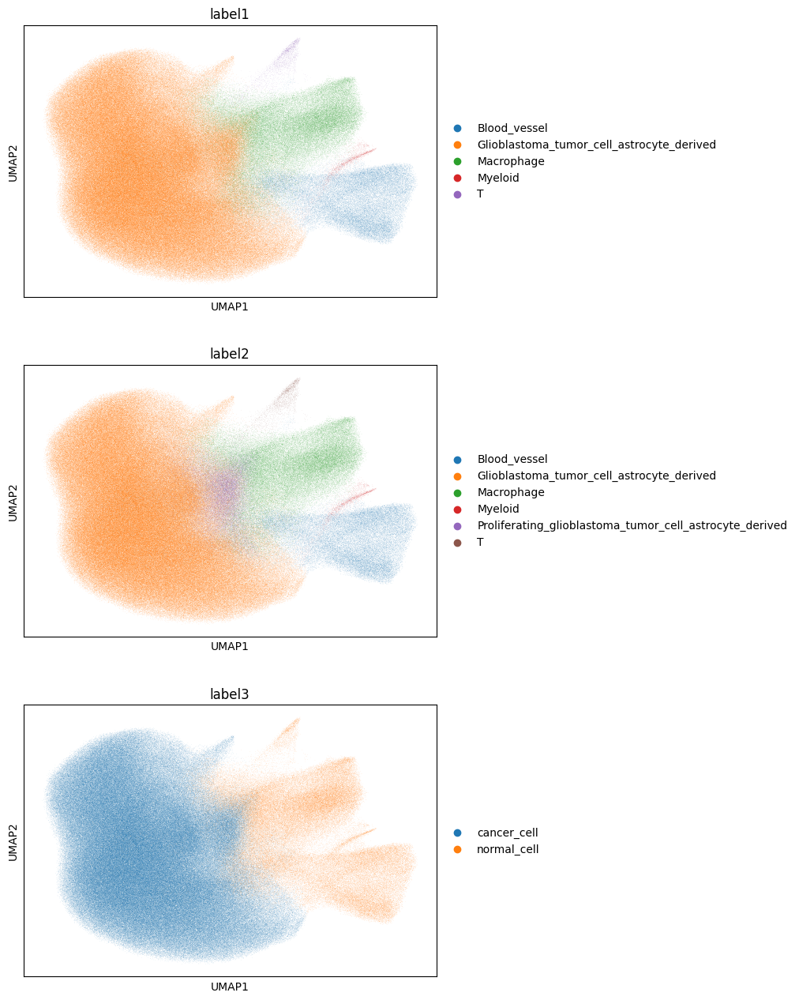

In [90]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [91]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,z_level,nucleus_count,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,207,0,0,0,0,207,60.148127,42.762970,cell_labels,0.0,1.0,0,2,4,2,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
1,aaaaaaab-1,231,0,0,0,0,231,78.842815,52.561877,cell_labels,0.0,1.0,0,1,0,1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
3,aaaaaaac-1,331,0,0,0,0,331,82.500472,34.138126,cell_labels,0.0,2.0,0,1,0,1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
4,aaaaaaad-1,75,0,0,0,0,75,43.937033,25.152032,cell_labels,0.0,1.0,3,4,5,4,Blood_vessel,Blood_vessel,normal_cell
5,aaaaaaae-1,246,0,0,0,0,246,67.011877,44.027345,cell_labels,0.0,1.0,0,1,0,1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816761,aaamfigm-1,28,0,0,0,0,28,27.455001,27.455001,cell_labels,5.0,1.0,1,0,1,0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
816762,aaamfign-1,22,0,0,0,0,22,17.791563,17.791563,cell_labels,5.0,1.0,3,4,8,4,Blood_vessel,Blood_vessel,normal_cell
816763,aaamfigo-1,72,0,0,0,0,72,115.690317,17.023907,cell_labels,4.0,1.0,3,7,8,7,Myeloid,Myeloid,normal_cell
816765,aaamfiha-1,16,0,0,0,0,16,7.586250,7.586250,cell_labels,5.0,1.0,1,0,8,0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell


In [92]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")